In [2]:
import math
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

import matplotlib.pyplot as plt

In [24]:
data = np.load("outer/12-2_0-0/AuAu200_170kHz_10C_Iter2_3001.xml_TPCMLDataInterface_0.npy")
data = data.astype(np.int16)

arr = np.sin(np.arange(192)[:, np.newaxis, np.newaxis])
arr = np.broadcast_to(arr, (192, 249, 16))
arr = arr.copy()

In [4]:
def plot_data(arr1, arr2):
    # Create the figure
    fig = plt.figure(figsize=(24, 8))  # Adjusted width to accommodate two plots

    # Create first subplot for the first array
    ax1 = fig.add_subplot(121, projection='3d')  # 121 means 1 row, 2 columns, first subplot

    # Create meshgrid for plotting
    x1, y1 = np.meshgrid(np.arange(arr1.shape[1]), np.arange(arr1.shape[0]))

    # Plot each layer for the first array
    for i in range(arr1.shape[2]):
        z1 = i * np.ones_like(x1)
        c1 = arr1[:,:,i]
        ax1.plot_surface(x1, y1, z1, facecolors=plt.cm.Reds(np.abs(c1)), 
                        rstride=1, cstride=1, alpha=0.3, shade=False)

    # Set labels and title for the first subplot
    ax1.set_xlabel('azimuthal')
    ax1.set_ylabel('z')
    ax1.set_zlabel('layer')
    ax1.set_title('3D Heatmap of sin(x) Array - Dataset 1')

    # Set axis limits for the first subplot
    ax1.set_xlim(0, arr1.shape[1])
    ax1.set_ylim(0, arr1.shape[0])
    ax1.set_zlim(0, arr1.shape[2])

    # Adjust the view angle for the first subplot
    ax1.view_init(elev=20, azim=-45)

    # Create second subplot for the second array
    ax2 = fig.add_subplot(122, projection='3d')  # 122 means 1 row, 2 columns, second subplot

    # Create meshgrid for plotting
    x2, y2 = np.meshgrid(np.arange(arr2.shape[1]), np.arange(arr2.shape[0]))

    # Plot each layer for the second array
    for i in range(arr2.shape[2]):
        z2 = i * np.ones_like(x2)
        c2 = arr2[:,:,i]
        ax2.plot_surface(x2, y2, z2, facecolors=plt.cm.Reds(np.abs(c2)), 
                        rstride=1, cstride=1, alpha=0.3, shade=False)

    # Set labels and title for the second subplot
    ax2.set_xlabel('azimuthal')
    ax2.set_ylabel('z')
    ax2.set_zlabel('layer')
    ax2.set_title('3D Heatmap of sin(x) Array - Dataset 2')

    # Set axis limits for the second subplot
    ax2.set_xlim(0, arr2.shape[1])
    ax2.set_ylim(0, arr2.shape[0])
    ax2.set_zlim(0, arr2.shape[2])

    # Adjust the view angle for the second subplot
    ax2.view_init(elev=20, azim=-45)

    plt.show()

In [5]:
class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.
    
    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the 
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a 
    # hyperparameter.
    
    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of 
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)
    
    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30):
        super().__init__()
        self.omega_0 = omega_0
        self.is_first = is_first
        
        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        
        self.init_weights()
    
    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features, 
                                             1 / self.in_features)      
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0, 
                                             np.sqrt(6 / self.in_features) / self.omega_0)
        
    def forward(self, input):
        return torch.sin(self.omega_0 * self.linear(input))

class SignalRegressor(nn.Module):
    def __init__(self, in_features,
                 hidden_features, hidden_layers, out_features, scale, outermost_linear):
        super().__init__()

        first_omega_0 = 30
        hidden_omega_0 = 30.
        self.net = []
        self.net.append(SineLayer(in_features, hidden_features, is_first = True, omega_0=first_omega_0))
        
        for i in range(hidden_layers-1):
            self.net.append(SineLayer(hidden_features, hidden_features, is_first = False, omega_0 = hidden_omega_0))

        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)
            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)
                
            self.net.append(final_linear)
        else:
            self.net.append(SineLayer(hidden_features, out_features, 
                                      is_first=False, omega_0=hidden_omega_0))
        self.net = nn.Sequential(*self.net)

    def forward(self, x):
        out = self.net(x)
        return out

In [6]:
class ArrayDataset(Dataset):
    def __init__(self, data):
        super().__init__()
        self.arr = data

    def __getitem__(self, idx):
        # Convert numpy array to torch tensor
        tensor_arr = torch.from_numpy(self.arr).float()

        # Create normalized coordinate grid
        h_axis = torch.linspace(0, 1, steps=self.arr.shape[0])
        w_axis = torch.linspace(0, 1, steps=self.arr.shape[1])
        d_axis = torch.linspace(0, 1, steps=self.arr.shape[2])
        grid = torch.stack(torch.meshgrid(h_axis, w_axis, d_axis, indexing='ij'), dim=-1)

        return grid, tensor_arr

    def __len__(self):
        return 1

In [7]:
def create_loader(data):
    array_data = ArrayDataset(data)
    return DataLoader(array_data, batch_size=1)

In [51]:
def train_model(array_loader, params):
    device = params["device"]
    total_steps = 1000
    summary_interval = 100

    grid, array = next(iter(array_loader))
    grid, array = grid.squeeze().to(device), array.squeeze().to(device)
    train_coords, train_values = grid.reshape(-1, 3), array.reshape(-1, 1)
    test_coords, test_values = grid.reshape(-1, 3), array.reshape(-1, 1)

    array_regressor = SignalRegressor(in_features=params["in_features"],
                                  hidden_features=params["hidden_features"], hidden_layers=params["hidden_layers"], 
                                      out_features=params["out_features"], scale=params["scale"],outermost_linear = params["outermost_linear"]).to(device)
    optim = torch.optim.Adam(lr=params["lr"], params=array_regressor.parameters())

    for step in range(1, total_steps+1):
        array_regressor.train()
        optim.zero_grad()
        output = array_regressor(train_coords)
        train_loss = F.mse_loss(output, train_values)
        train_loss.backward()
        optim.step()

        if not step % summary_interval:
            array_regressor.eval()
            with torch.no_grad():
                prediction = array_regressor(test_coords)
                test_loss = F.mse_loss(prediction, test_values)
                #test_psnr = -10*torch.log10(test_loss)

                print(f"Step: {step}, Test MSE: {test_loss.item():.6f}")
                plot_data(prediction.reshape_as(array).cpu(), array.cpu())

    return array_regressor, prediction, test_loss

Step: 100, Test PSNR: 3.158849


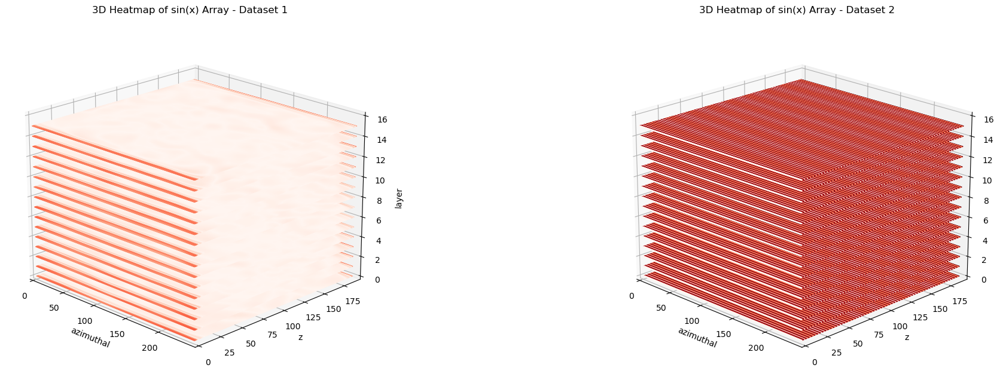

Step: 200, Test PSNR: 4.477954


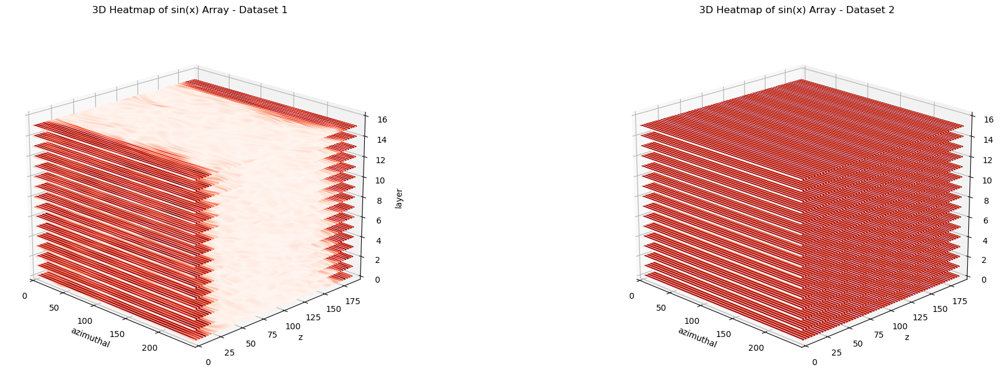

Step: 300, Test PSNR: 7.640929
Step: 400, Test PSNR: 16.374699


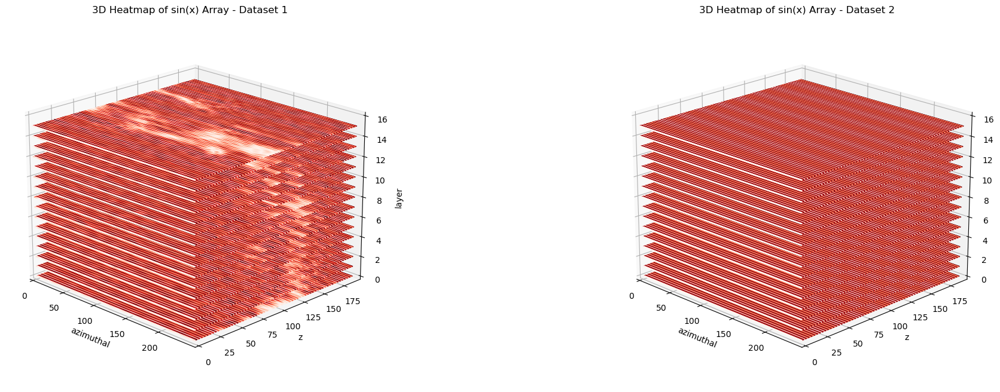

Step: 500, Test PSNR: 23.474609


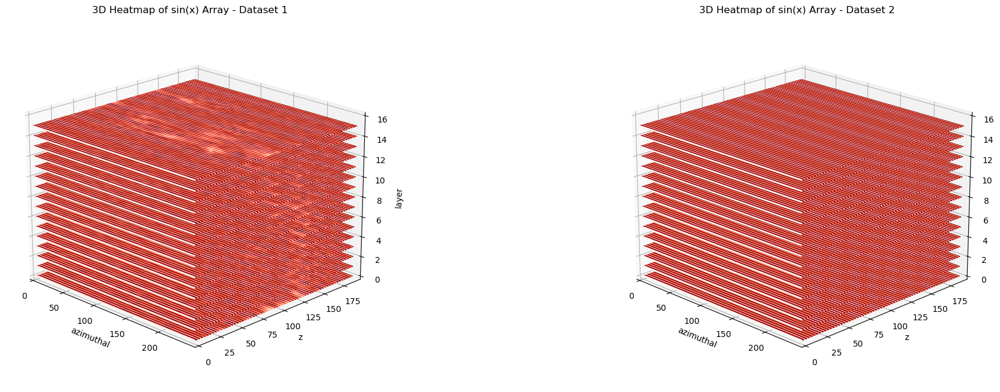

Step: 600, Test PSNR: 27.144308


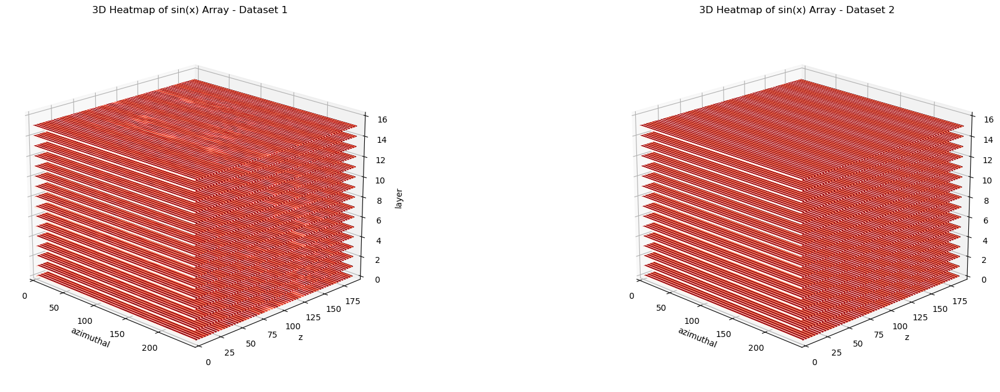

Step: 700, Test PSNR: 29.602062


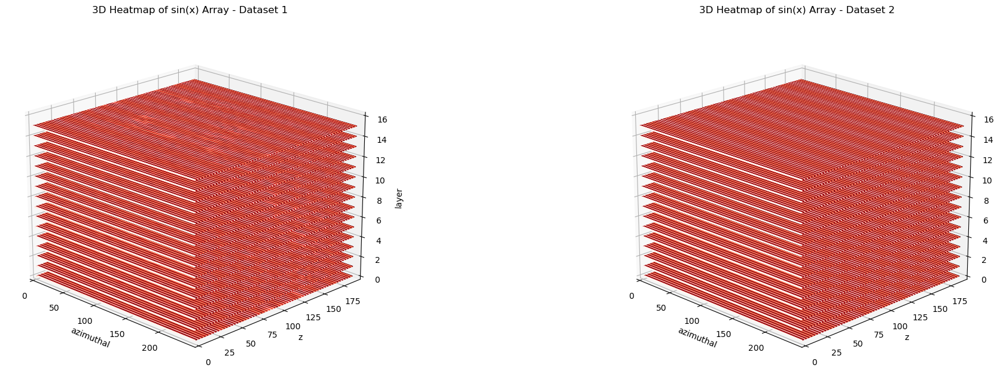

Step: 800, Test PSNR: 28.867584


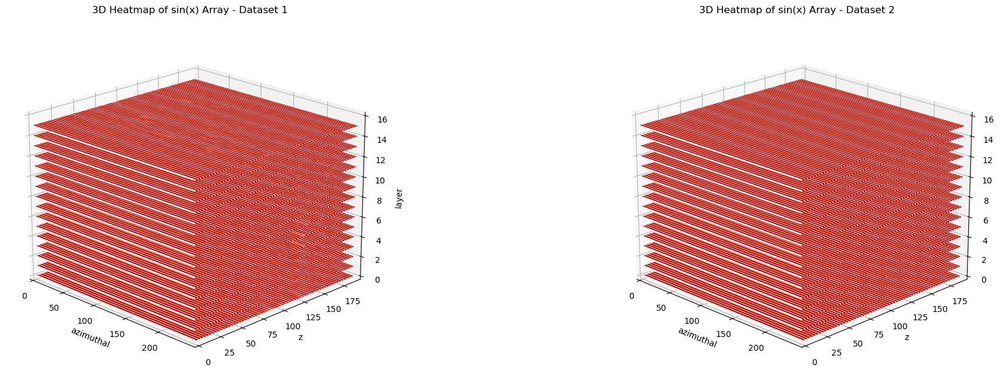

Step: 900, Test PSNR: 25.874794


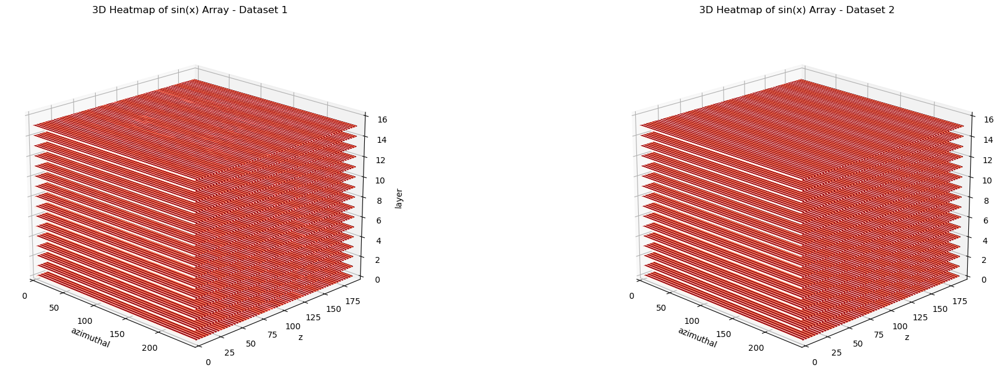

Step: 1000, Test PSNR: 32.450737


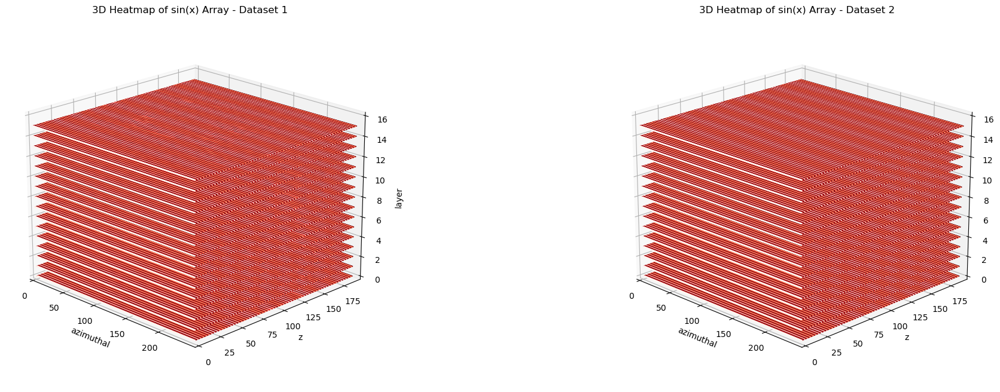

In [24]:
params = {"hidden_features":256,
          "hidden_layers":4,
          "in_features":3,
          "out_features":1,
          "scale":10,
          "device": torch.device("cuda" if torch.cuda.is_available() else "cpu"),
          "lr":1e-4,
          "outermost_linear":True
         }

array_loader = create_loader(arr)
array_regressor, array_prediction, array_psnr = train_model(array_loader, params)

Step: 100, Test PSNR: -32.465969


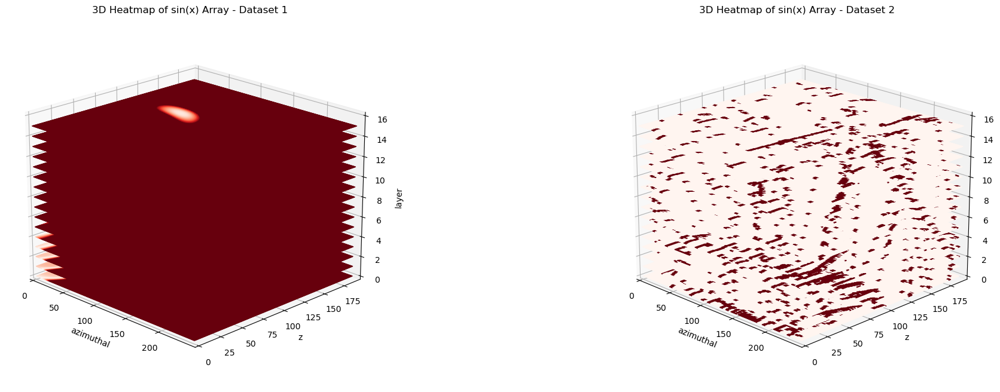

Step: 200, Test PSNR: -32.366825


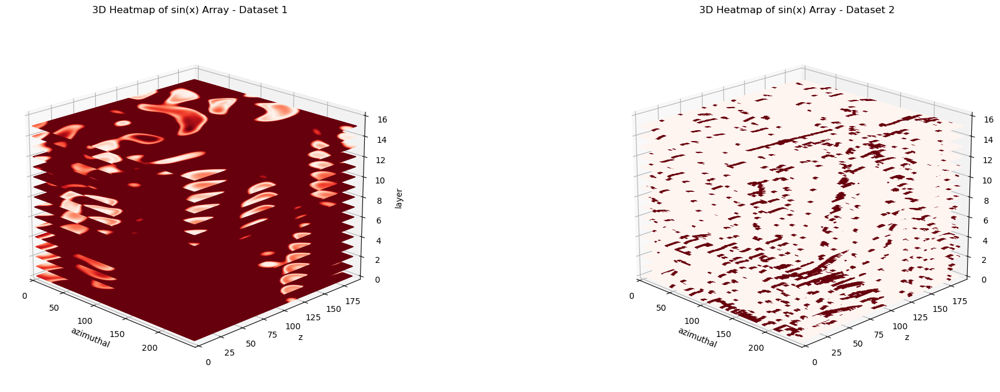

Step: 300, Test PSNR: -32.248211


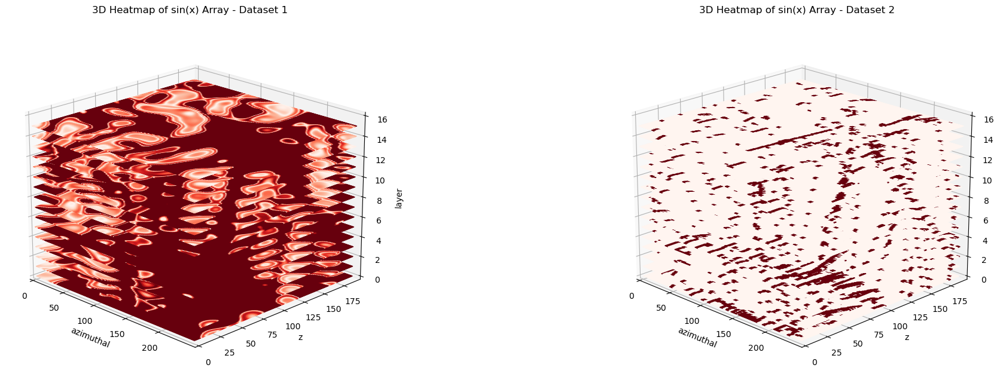

Step: 400, Test PSNR: -32.139996


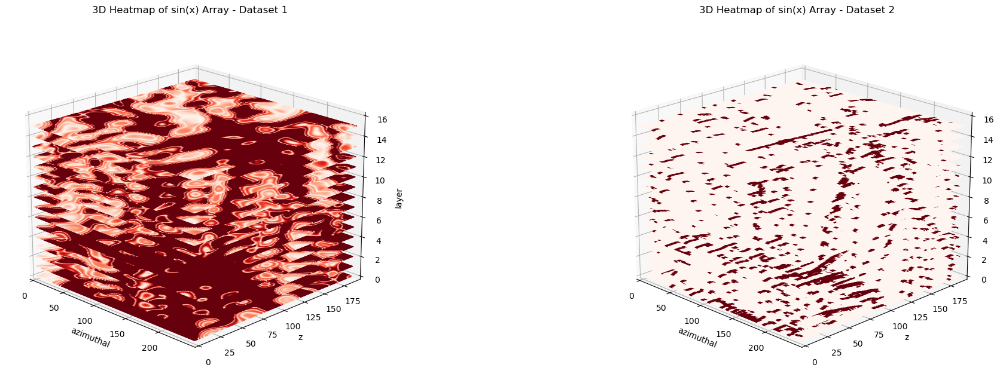

Step: 500, Test PSNR: -32.028442


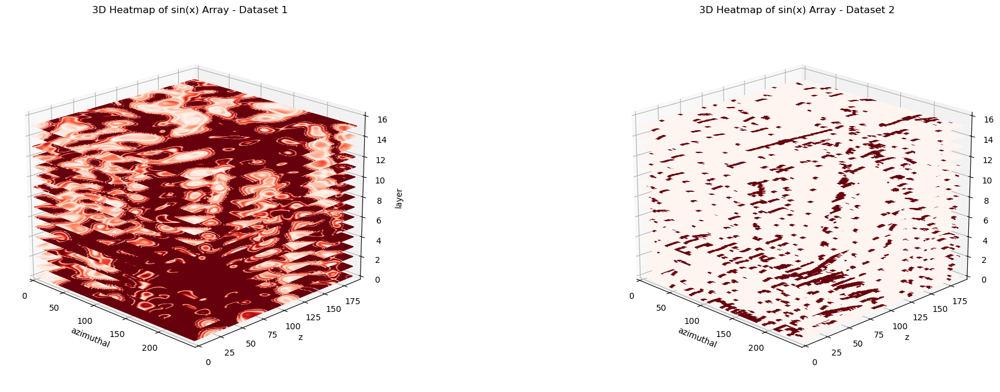

Step: 600, Test PSNR: -31.917849


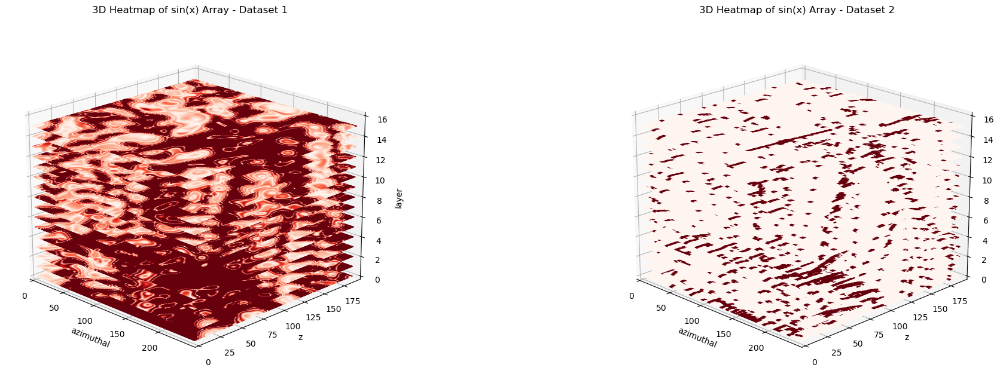

Step: 700, Test PSNR: -31.813009


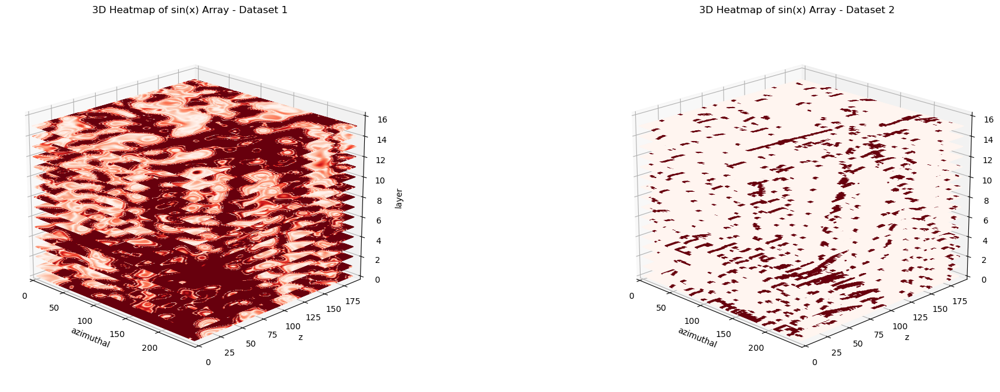

Step: 800, Test PSNR: -31.699249


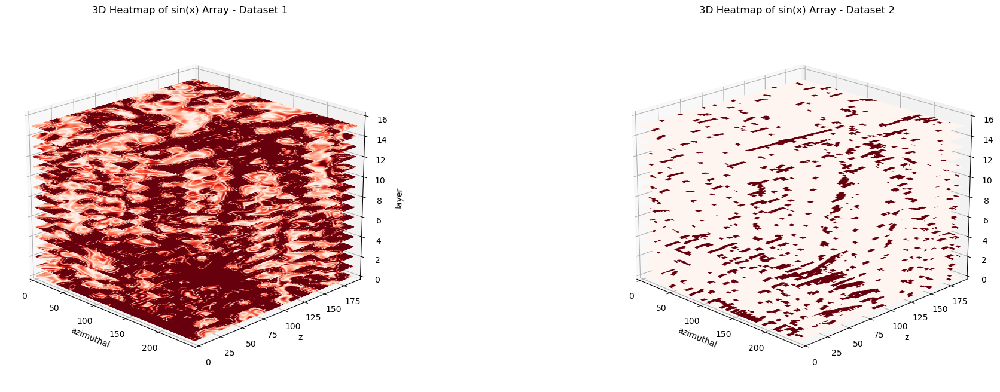

Step: 900, Test PSNR: -31.587046


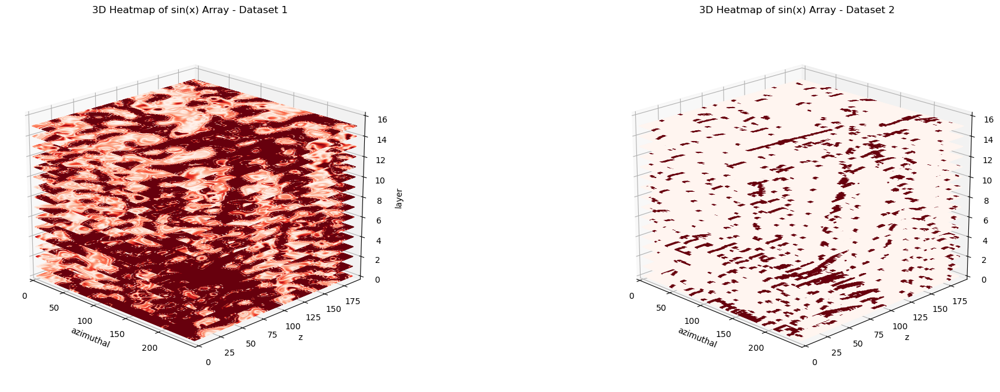

Step: 1000, Test PSNR: -31.471710


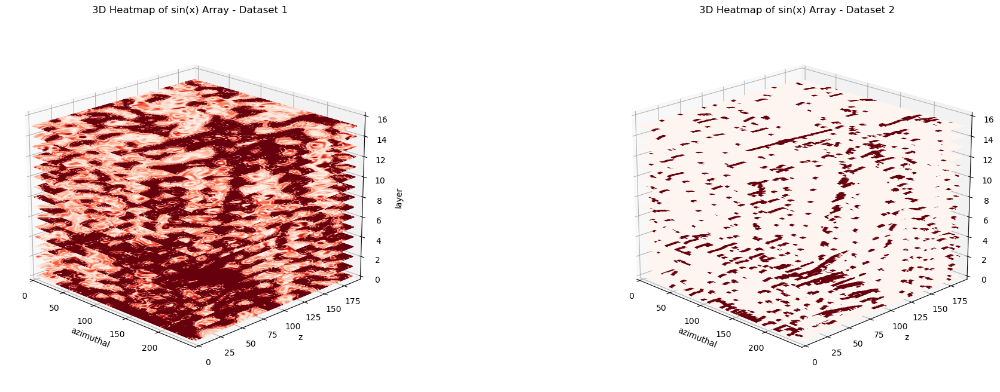

In [11]:
params = {"hidden_features":256,
          "hidden_layers":4,
          "in_features":3,
          "out_features":1,
          "scale":10,
          "device": torch.device("cuda" if torch.cuda.is_available() else "cpu"),
          "lr":1e-4,
          "outermost_linear":True
         }

accel_loader = create_loader(data)
accel_regressor, accel_prediction, accel_psnr = train_model(accel_loader, params)

In [44]:
def transform_array(arr):
    # Create a copy of the input array as float
    result = arr.astype(float)
    
    # Create a mask for values greater than 64
    valid_mask = result > 64
    
    # Apply the transformation only to valid elements
    result[valid_mask] = np.log(result[valid_mask] - 64) / 6
    
    return result

In [60]:
log_data = transform_array(data)

Step: 100, Test MSE: 0.020163


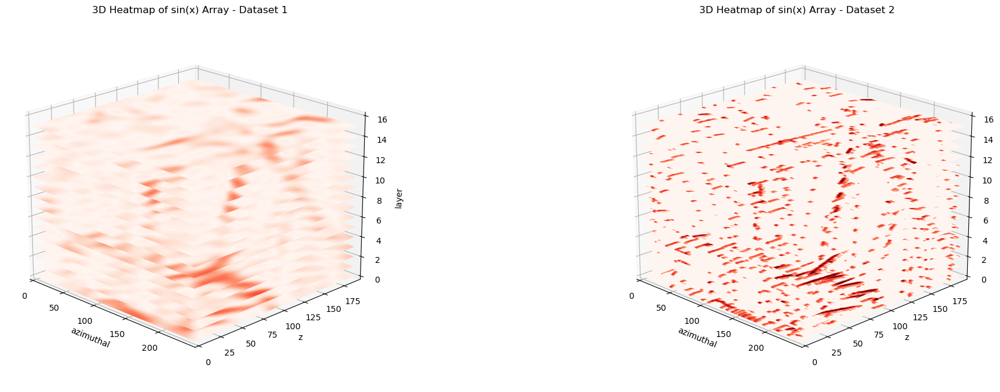

Step: 200, Test MSE: 0.011808


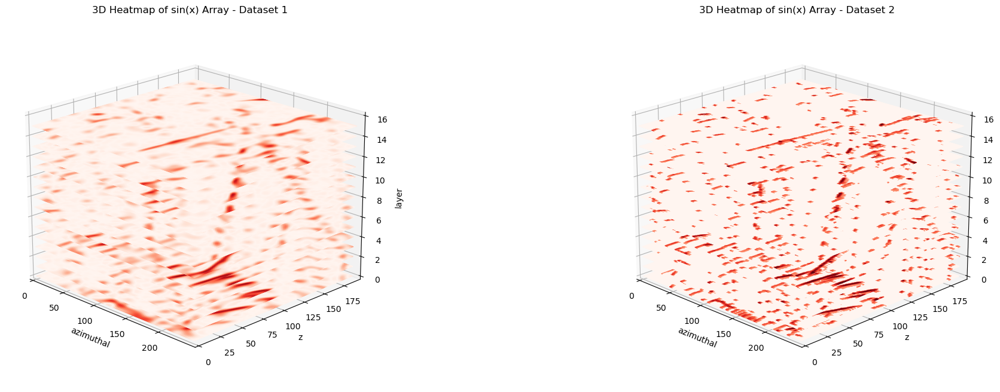

Step: 300, Test MSE: 0.005728


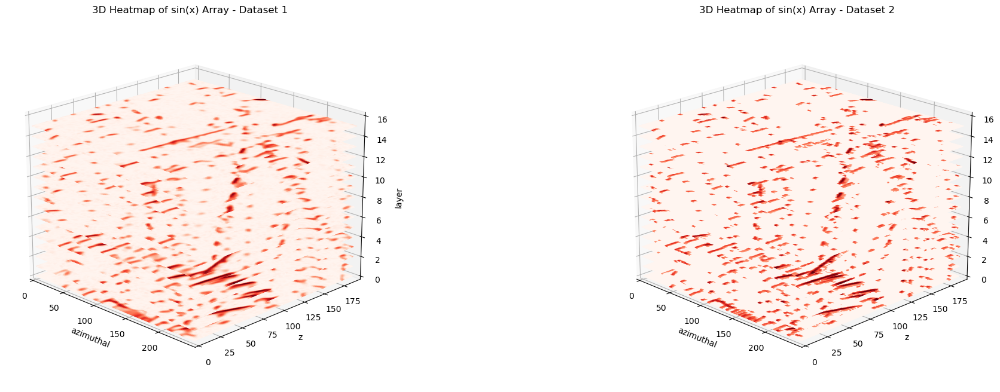

Step: 400, Test MSE: 0.003817


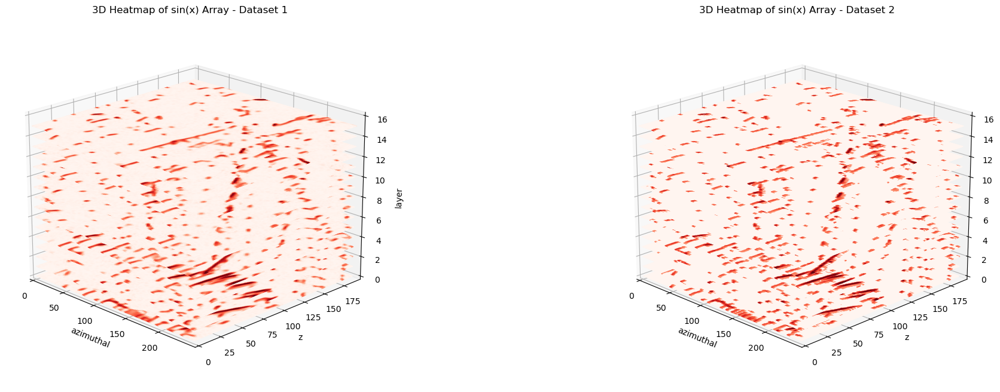

Step: 500, Test MSE: 0.003115


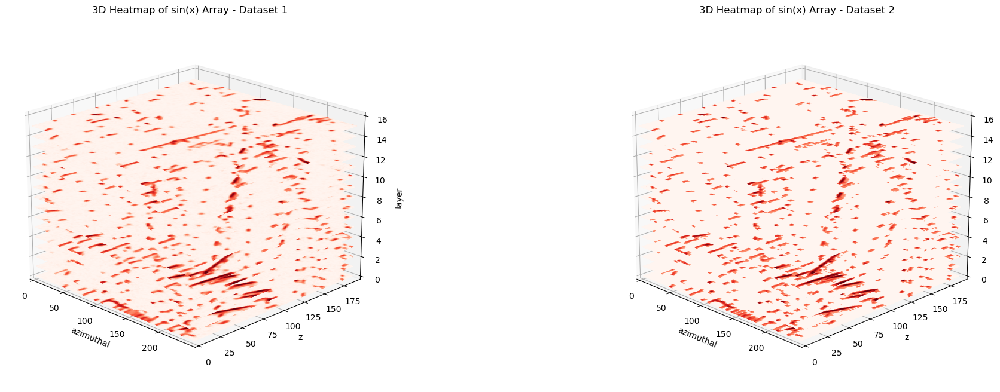

Step: 600, Test MSE: 0.002742


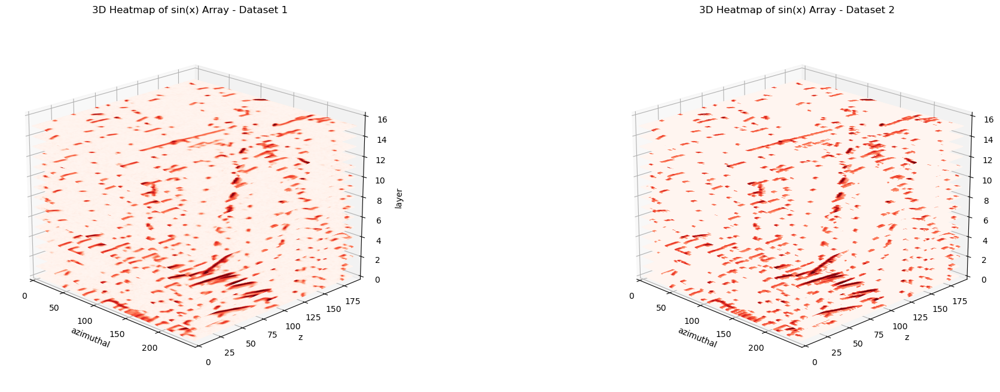

Step: 700, Test MSE: 0.002488


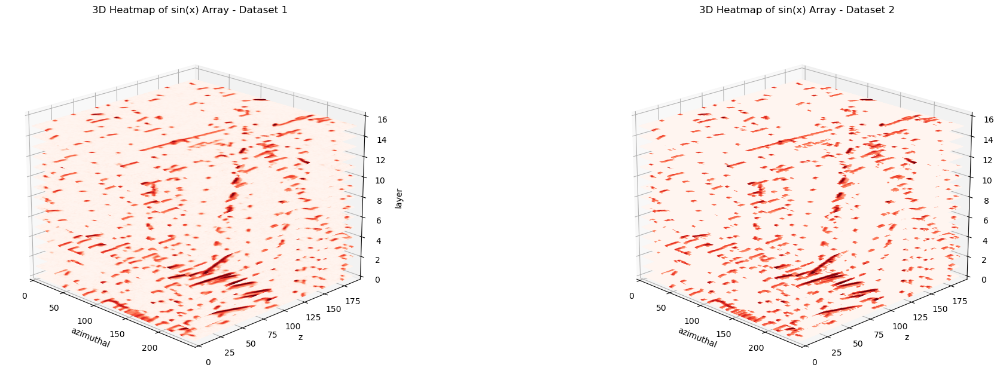

Step: 800, Test MSE: 0.002317


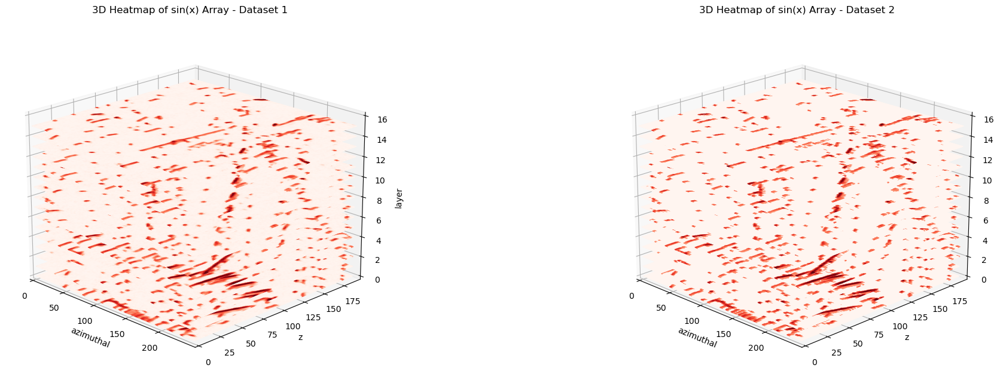

Step: 900, Test MSE: 0.002168


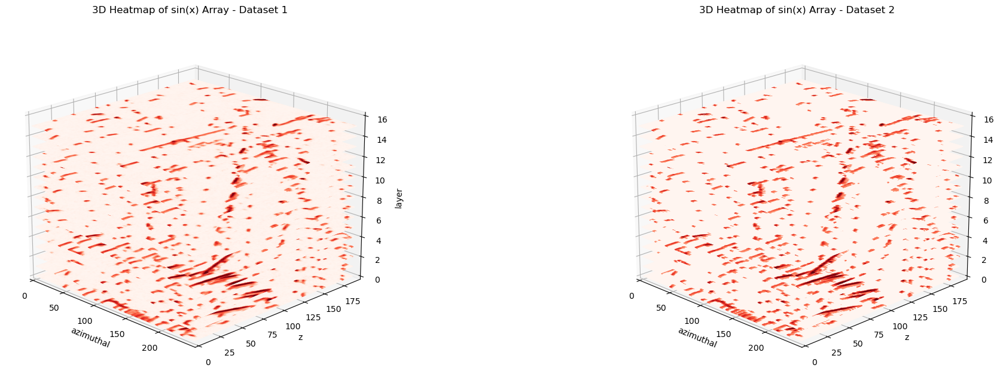

Step: 1000, Test MSE: 0.002071


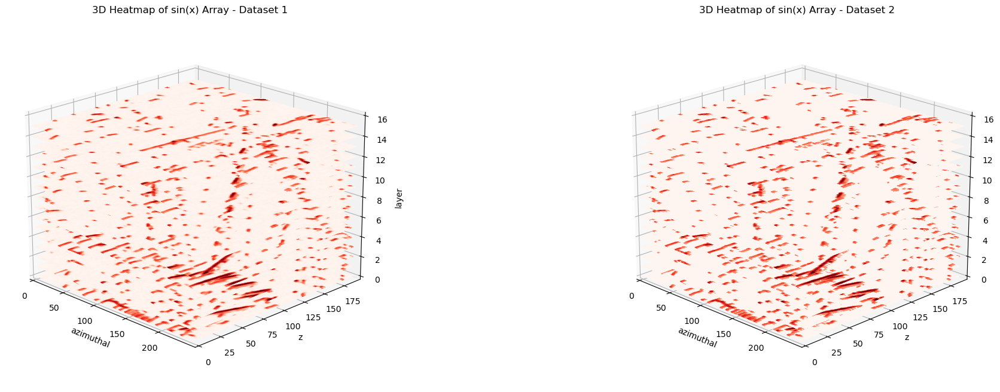

In [61]:
params = {"hidden_features":256,
          "hidden_layers":4,
          "in_features":3,
          "out_features":1,
          "scale":10,
          "device": torch.device("cuda" if torch.cuda.is_available() else "cpu"),
          "lr":1e-4,
          "outermost_linear":True
         }

accel_log_loader = create_loader(log_data)
accel_log_regressor, accel_log_prediction, accel_log_psnr = train_model(accel_log_loader, params)

In [ ]:
log_data_larger = log_data*6

Step: 100, Test MSE: 0.001055


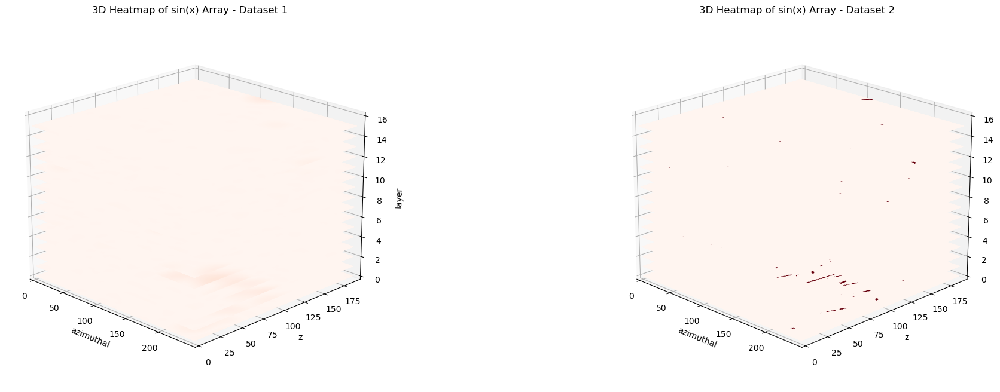

Step: 200, Test MSE: 0.001019


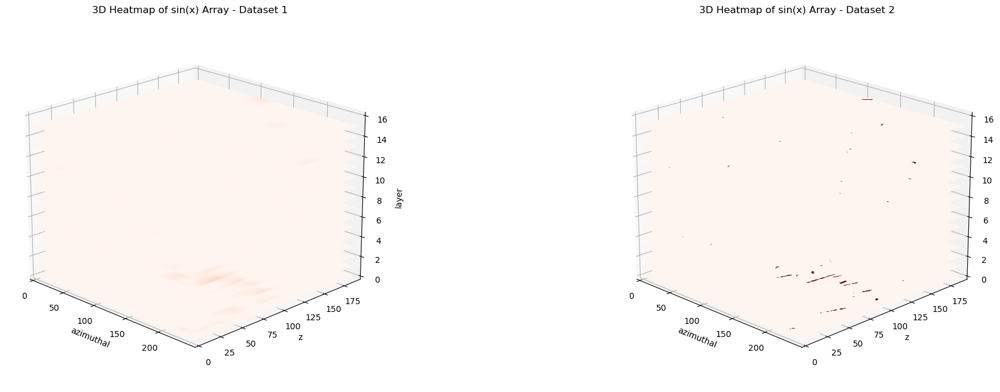

Step: 300, Test MSE: 0.000973


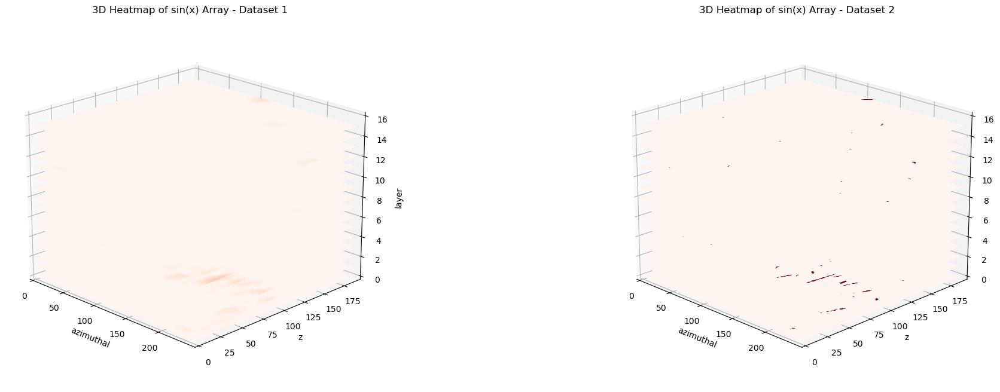

Step: 400, Test MSE: 0.000917


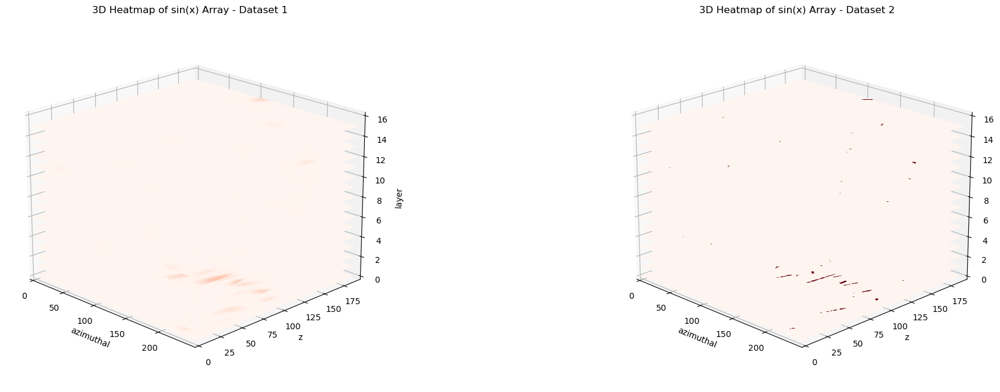

Step: 500, Test MSE: 0.000859


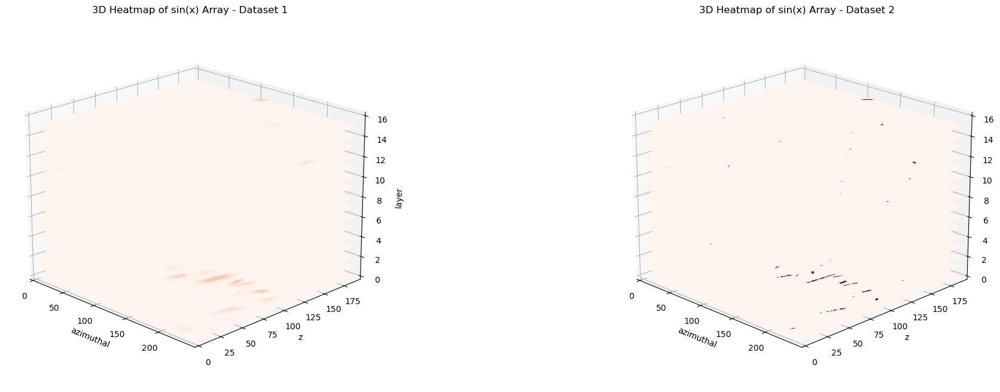

Step: 600, Test MSE: 0.000800


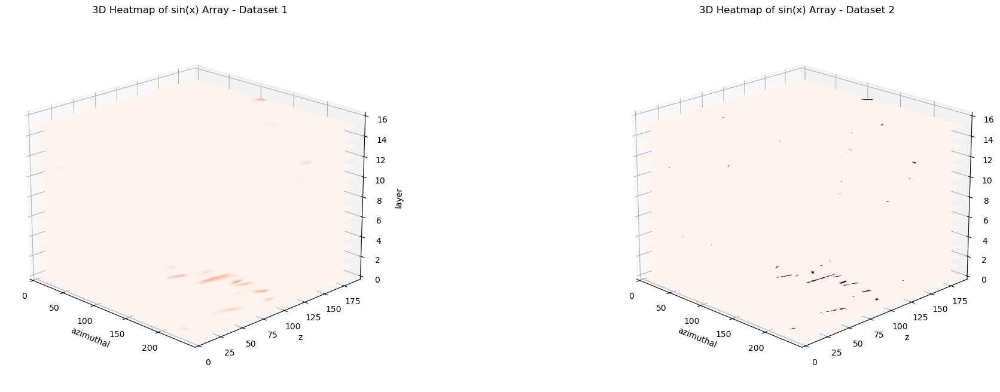

Step: 700, Test MSE: 0.000737


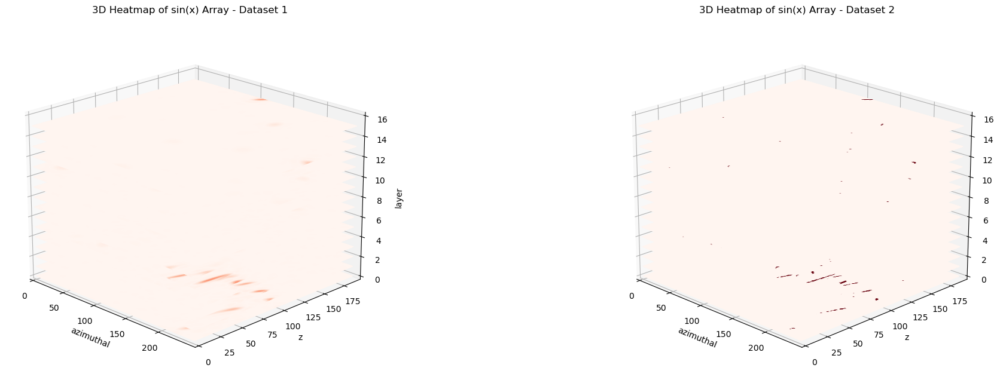

Step: 800, Test MSE: 0.000672


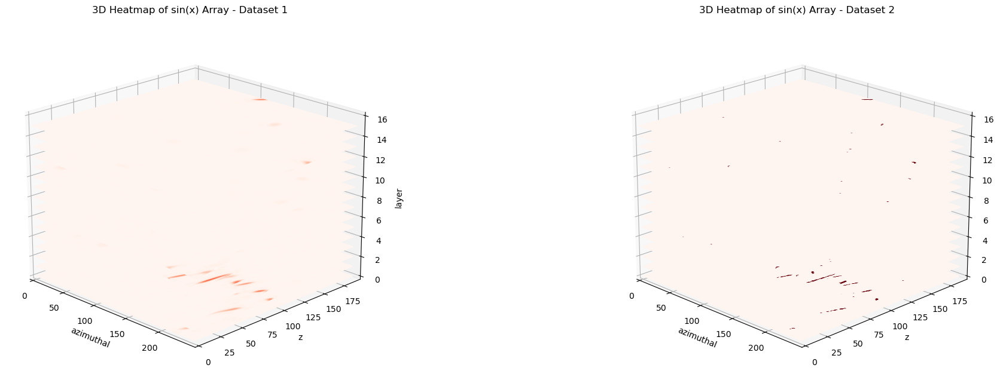

Step: 900, Test MSE: 0.000609


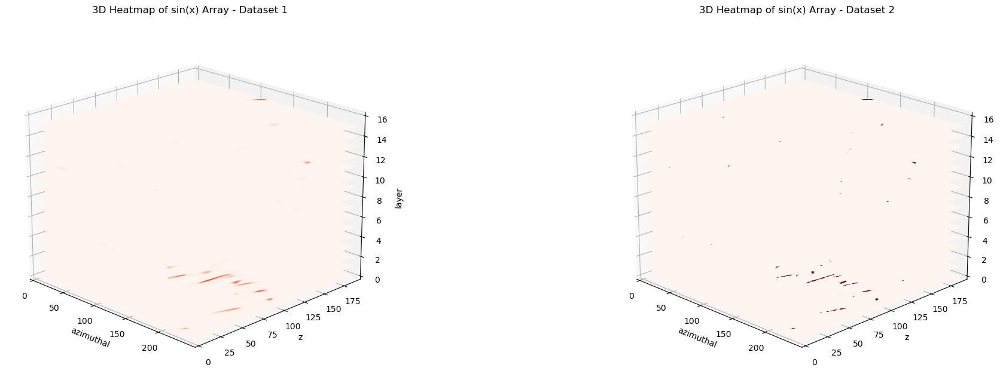

Step: 1000, Test MSE: 0.000552


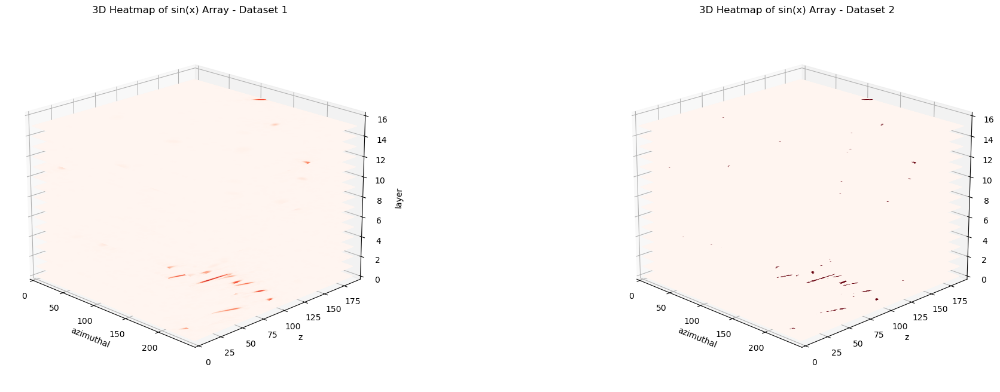

In [53]:
params = {"hidden_features":256,
          "hidden_layers":4,
          "in_features":3,
          "out_features":1,
          "scale":10,
          "device": torch.device("cuda" if torch.cuda.is_available() else "cpu"),
          "lr":1e-4,
          "outermost_linear":True
         }

accel_log_larger_loader = create_loader(log_data_larger)
accel_log_larger_regressor, accel_log_larger_prediction, accel_log_larger_psnr = train_model(accel_log_larger_loader, params)